# Masked Autoencoders: Implementation for 4K Video.

The following setup section is taken from the Facebook MAE demo.ipynb: https://github.com/facebookresearch/mae/blob/main/demo/mae_visualize.ipynb


In [1]:
import sys
import os
import requests

import torch
import numpy as np

import matplotlib.pyplot as plt
from PIL import Image

# check whether run in Colab
if 'google.colab' in sys.modules:
    print('Running in Colab.')
    !pip3 install timm==0.4.5  # 0.3.2 does not work in Colab
    !git clone https://github.com/facebookresearch/mae.git
    sys.path.append('./mae')
else:
    sys.path.append('..')
import models_mae

/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# define the utils

imagenet_mean = np.array([0.485, 0.456, 0.406])
imagenet_std = np.array([0.229, 0.224, 0.225])

def show_image(image, title=''):
    # image is [H, W, 3]
    assert image.shape[2] == 3
    plt.imshow(torch.clip((image * imagenet_std + imagenet_mean) * 255, 0, 255).int())
    plt.title(title, fontsize=16)
    plt.axis('off')
    return

def prepare_model(chkpt_dir, arch='mae_vit_large_patch16'):
    # build model
    model = getattr(models_mae, arch)()
    # load model
    checkpoint = torch.load(chkpt_dir, map_location='cpu')
    msg = model.load_state_dict(checkpoint['model'], strict=False)
    print(msg)
    return model

def run_one_image(img, model):
    x = torch.tensor(img)

    # make it a batch-like
    x = x.unsqueeze(dim=0)
    x = torch.einsum('nhwc->nchw', x)

    # run MAE
    loss, y, mask = model(x.float(), mask_ratio=0.75)
    y = model.unpatchify(y)
    y = torch.einsum('nchw->nhwc', y).detach().cpu()

    # visualize the mask
    mask = mask.detach()
    mask = mask.unsqueeze(-1).repeat(1, 1, model.patch_embed.patch_size[0]**2 *3)  # (N, H*W, p*p*3)
    mask = model.unpatchify(mask)  # 1 is removing, 0 is keeping
    mask = torch.einsum('nchw->nhwc', mask).detach().cpu()
    
    x = torch.einsum('nchw->nhwc', x)

    # masked image
    im_masked = x * (1 - mask)

    # MAE reconstruction pasted with visible patches
    im_paste = x * (1 - mask) + y * mask

    # make the plt figure larger
    plt.rcParams['figure.figsize'] = [24, 24]

    plt.subplot(1, 4, 1)
    show_image(x[0], "original")

    plt.subplot(1, 4, 2)
    show_image(im_masked[0], "masked")

    plt.subplot(1, 4, 3)
    show_image(y[0], "reconstruction")

    plt.subplot(1, 4, 4)
    show_image(im_paste[0], "reconstruction + visible")

    plt.show()


### Load an image

/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/23985122.py:9: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  plt.imshow(torch.clip((image * imagenet_std + imagenet_mean) * 255, 0, 255).int())


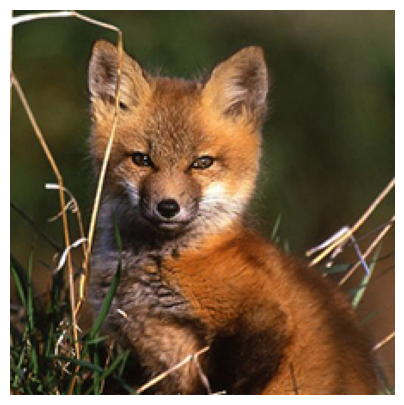

In [3]:
# load an image
img_url = 'https://user-images.githubusercontent.com/11435359/147738734-196fd92f-9260-48d5-ba7e-bf103d29364d.jpg' # fox, from ILSVRC2012_val_00046145
# img_url = 'https://user-images.githubusercontent.com/11435359/147743081-0428eecf-89e5-4e07-8da5-a30fd73cc0ba.jpg' # cucumber, from ILSVRC2012_val_00047851
img = Image.open(requests.get(img_url, stream=True).raw)
img = img.resize((224, 224))
img = np.array(img) / 255.

assert img.shape == (224, 224, 3)

# normalize by ImageNet mean and std
img = img - imagenet_mean
img = img / imagenet_std

plt.rcParams['figure.figsize'] = [5, 5]
show_image(torch.tensor(img))

### Load a pre-trained MAE model

In [4]:
# This is an MAE model trained with pixels as targets for visualization (ViT-Large, training mask ratio=0.75)
# download checkpoint if not exist
# !wget -nc https://dl.fbaipublicfiles.com/mae/visualize/mae_visualize_vit_large.pth

chkpt_dir = 'mae_visualize_vit_large.pth'
model_mae = prepare_model(chkpt_dir, 'mae_vit_large_patch16')
print('Model loaded.')


<All keys matched successfully>
Model loaded.


### Run MAE on the image

MAE with pixel reconstruction:


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/23985122.py:9: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  plt.imshow(torch.clip((image * imagenet_std + imagenet_mean) * 255, 0, 255).int())


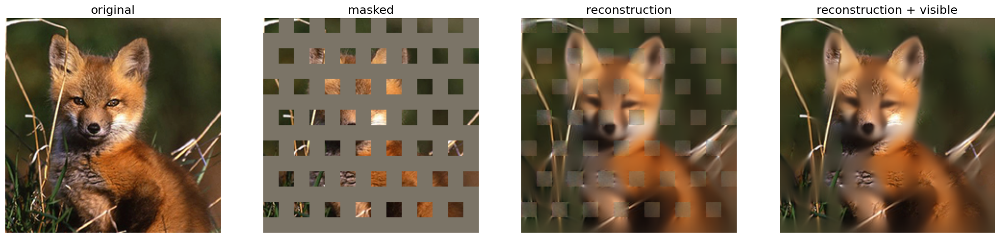

In [5]:
# make random mask reproducible (comment out to make it change)
torch.manual_seed(2)
print('MAE with pixel reconstruction:')
run_one_image(img, model_mae)

### Load another pre-trained MAE model

In [6]:
# This is an MAE model trained with an extra GAN loss for more realistic generation (ViT-Large, training mask ratio=0.75)

# download checkpoint if not exist

chkpt_dir = 'mae_visualize_vit_large_ganloss.pth'
model_mae_gan = prepare_model('mae_visualize_vit_large_ganloss.pth', 'mae_vit_large_patch16')
print('Model loaded.')

<All keys matched successfully>
Model loaded.


### Run MAE on the image

MAE with extra GAN loss:


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/23985122.py:9: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  plt.imshow(torch.clip((image * imagenet_std + imagenet_mean) * 255, 0, 255).int())


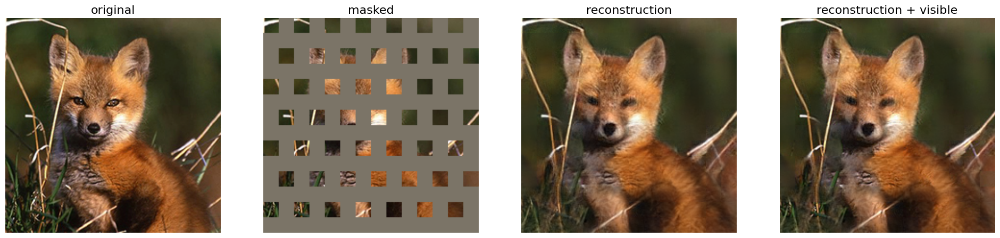

In [7]:
# make random mask reproducible (comment out to make it change)
torch.manual_seed(2)
print('MAE with extra GAN loss:')
run_one_image(img, model_mae_gan)

---
---
## The Remainder of this document was developed specifically for the 229 Final Project
---
---

In [8]:
def reconstruct(img, model):
    x = torch.tensor(img)
    x = x.unsqueeze(dim=0)
    x = torch.einsum('nhwc->nchw', x)
    loss, y, mask = model(x.float(), mask_ratio=0.75)
    y = model.unpatchify(y)
    y = torch.einsum('nchw->nhwc', y).detach().cpu()
    mask = mask.detach()
    mask = mask.unsqueeze(-1).repeat(1, 1, model.patch_embed.patch_size[0]**2 *3)  # (N, H*W, p*p*3)
    mask = model.unpatchify(mask)  # 1 is removing, 0 is keeping
    mask = torch.einsum('nchw->nhwc', mask).detach().cpu()
    x = torch.einsum('nchw->nhwc', x)
    im_paste = x * (1 - mask) + y * mask
    return torch.clip((im_paste * imagenet_std + imagenet_mean) * 255, 0, 255).int()

def raw(img, model):
    x = torch.tensor(img)
    x = x.unsqueeze(dim=0)
    x = torch.einsum('nhwc->nchw', x)
    loss, y, mask = model(x.float(), mask_ratio=0.75)
    y = model.unpatchify(y)
    y = torch.einsum('nchw->nhwc', y).detach().cpu()
    mask = mask.detach()
    mask = mask.unsqueeze(-1).repeat(1, 1, model.patch_embed.patch_size[0]**2 *3)  # (N, H*W, p*p*3)
    mask = model.unpatchify(mask)  # 1 is removing, 0 is keeping
    mask = torch.einsum('nchw->nhwc', mask).detach().cpu()
    x = torch.einsum('nchw->nhwc', x)
    im_masked = x * (1 - mask)

    return torch.clip((im_masked * imagenet_std + imagenet_mean) * 255, 0, 255).int()

In [9]:
noise = torch.sort(torch.rand(1, 196)).values

print(noise)


len_keep = int(196 * (1 - 0.95))

ids_shuffle = torch.argsort(noise, dim=1)  # ascend: small is keep, large is remove
print(ids_shuffle)

ids_restore = torch.argsort(ids_shuffle, dim=1)
print(ids_restore)

ids_keep = ids_shuffle[:, :len_keep]
print(ids_keep)

tensor([[0.0021, 0.0064, 0.0103, 0.0114, 0.0139, 0.0163, 0.0241, 0.0303, 0.0310,
         0.0326, 0.0367, 0.0438, 0.0445, 0.0458, 0.0503, 0.0541, 0.0573, 0.0618,
         0.0651, 0.0652, 0.0716, 0.0727, 0.0729, 0.0757, 0.0779, 0.0958, 0.1057,
         0.1147, 0.1357, 0.1376, 0.1416, 0.1489, 0.1580, 0.1611, 0.1673, 0.1712,
         0.1755, 0.1839, 0.1884, 0.1889, 0.1890, 0.1942, 0.1960, 0.2050, 0.2060,
         0.2085, 0.2159, 0.2166, 0.2200, 0.2259, 0.2357, 0.2509, 0.2571, 0.2601,
         0.2708, 0.2762, 0.2774, 0.2958, 0.3078, 0.3081, 0.3173, 0.3217, 0.3232,
         0.3324, 0.3392, 0.3393, 0.3406, 0.3430, 0.3781, 0.3810, 0.3892, 0.3897,
         0.3901, 0.3926, 0.3984, 0.4058, 0.4071, 0.4194, 0.4194, 0.4247, 0.4261,
         0.4386, 0.4425, 0.4518, 0.4525, 0.4531, 0.4604, 0.4623, 0.4660, 0.4686,
         0.4737, 0.4745, 0.4760, 0.4770, 0.4777, 0.4811, 0.4921, 0.4947, 0.4956,
         0.4957, 0.5109, 0.5221, 0.5237, 0.5246, 0.5294, 0.5332, 0.5334, 0.5382,
         0.5409, 0.5410, 0.5

In [10]:

tensor = torch.ones(1, 196)
tensor[:, ::4] = 0
tensor[:,1::4] = 0
tensor[:,2::4] = 0
tensor[:,4::4] = 0

noise = tensor

print(noise)

len_keep = int(196 * (1 - 0.95))

ids_shuffle = torch.argsort(noise, dim=1)  # ascend: small is keep, large is remove
print(ids_shuffle)

ids_restore = torch.argsort(ids_shuffle, dim=1)
print(ids_restore)

ids_keep = ids_shuffle[:, :len_keep]
print(ids_keep)

tensor([[0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0.,
         0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1.,
         0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0.,
         0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1.,
         0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0.,
         0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1.,
         0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0.,
         0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1.,
         0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0.,
         0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1.,
         0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 1.]])
tensor([[ 98,   0, 193,   2, 100,   5, 101,   8, 102,  10,  12,  14,  16,  17,
          18,  20,  21,  22,  24,  2

In [11]:
print((224*9) , (224*5))
print((224*9) / (224*5))
print(16/9)

2016 1120
1.8
1.7777777777777777


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/23985122.py:9: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  plt.imshow(torch.clip((image * imagenet_std + imagenet_mean) * 255, 0, 255).int())


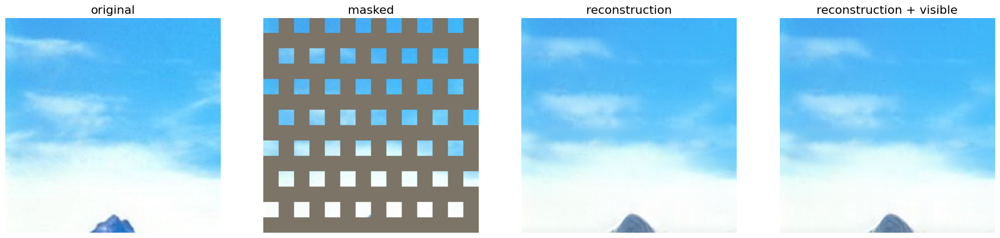

In [12]:
full_img = Image.open("nature.jpg")
full_img = full_img.resize((2016, 1120))

img = full_img
img = np.array(img)[0:224,0:224] / 255.

assert img.shape == (224, 224, 3)

img = img - imagenet_mean
img = img / imagenet_std

run_one_image(img, model_mae_gan)

MAE with pixel reconstruction:


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/155843506.py:14: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return torch.clip((im_paste * imagenet_std + imagenet_mean) * 255, 0, 255).int()
/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/2478029312.py:13: DeprecationWarning: __array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments.
  new_img[y*224:(y+1)*224, x*224:(x+1)*224] = reconstruct(img, model_mae).int()[0]


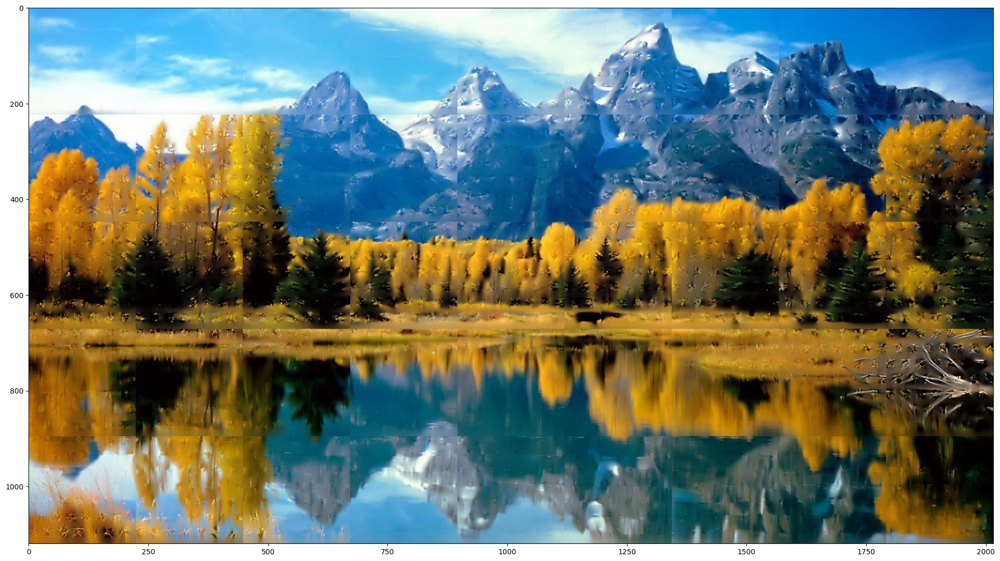

In [13]:
torch.manual_seed(2)
print('MAE with pixel reconstruction:')

new_img = np.zeros((1120, 2016, 3)).astype(int)

for y in range(5):
    for x in range(9):
        img = np.array(full_img)[y*224:(y+1)*224, x*224:(x+1)*224] / 255.

        img = img - imagenet_mean
        img = img / imagenet_std
        
        new_img[y*224:(y+1)*224, x*224:(x+1)*224] = reconstruct(img, model_mae).int()[0]

plt.imshow(new_img)

MAE with pixel reconstruction:


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/155843506.py:14: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return torch.clip((im_paste * imagenet_std + imagenet_mean) * 255, 0, 255).int()
/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/914799992.py:13: DeprecationWarning: __array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments.
  new_img[y*224:(y+1)*224, x*224:(x+1)*224] = reconstruct(img, model_mae_gan).int()[0]


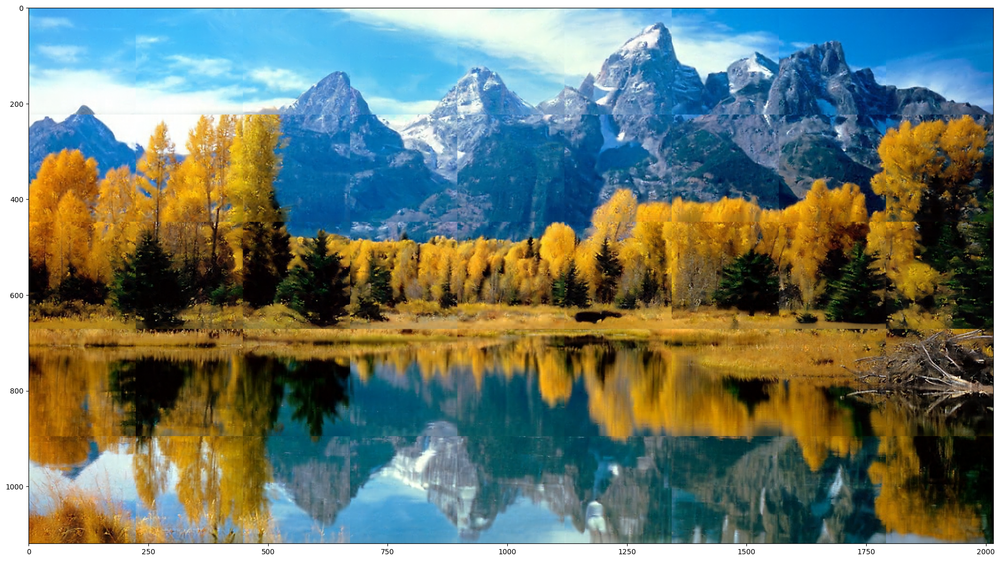

In [14]:
torch.manual_seed(2)
print('MAE with pixel reconstruction:')

new_img = np.zeros((1120, 2016, 3)).astype(int)

for y in range(5):
    for x in range(9):
        img = np.array(full_img)[y*224:(y+1)*224, x*224:(x+1)*224] / 255.

        img = img - imagenet_mean
        img = img / imagenet_std
        
        new_img[y*224:(y+1)*224, x*224:(x+1)*224] = reconstruct(img, model_mae_gan).int()[0]

plt.imshow(new_img)

MAE with pixel reconstruction:


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/155843506.py:30: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return torch.clip((im_masked * imagenet_std + imagenet_mean) * 255, 0, 255).int()
/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/141614219.py:13: DeprecationWarning: __array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments.
  new_img[y*224:(y+1)*224, x*224:(x+1)*224] = raw(img, model_mae).int()[0]


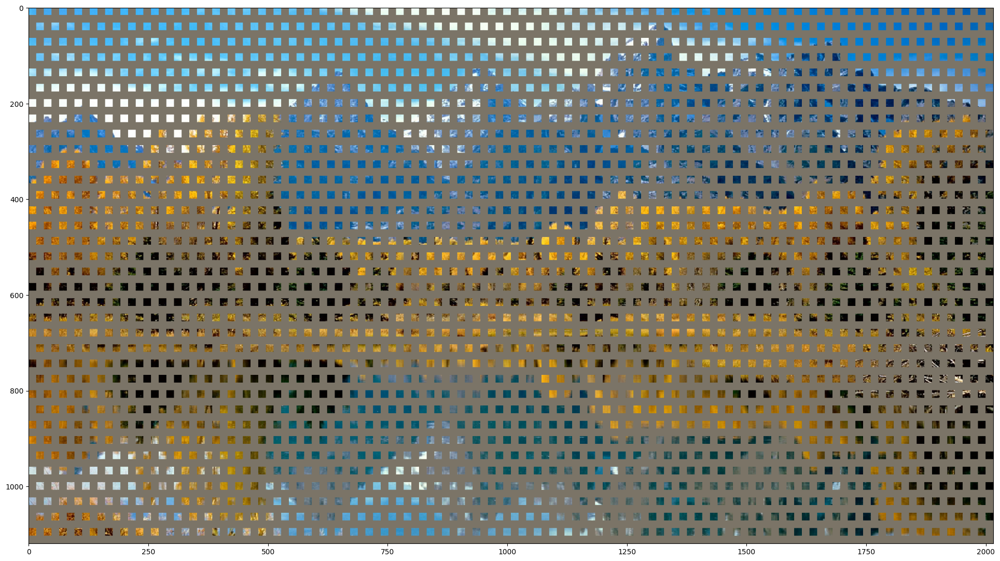

In [15]:
torch.manual_seed(2)
print('MAE with pixel reconstruction:')

new_img = np.zeros((1120, 2016, 3)).astype(int)

for y in range(5):
    for x in range(9):
        img = np.array(full_img)[y*224:(y+1)*224, x*224:(x+1)*224] / 255.

        img = img - imagenet_mean
        img = img / imagenet_std
        
        new_img[y*224:(y+1)*224, x*224:(x+1)*224] = raw(img, model_mae).int()[0]

plt.imshow(new_img)

In [16]:
full_img = Image.open("venice.webp")
full_img = full_img.resize((2016, 1120))

MAE with pixel reconstruction:


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/155843506.py:14: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return torch.clip((im_paste * imagenet_std + imagenet_mean) * 255, 0, 255).int()
/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/914799992.py:13: DeprecationWarning: __array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments.
  new_img[y*224:(y+1)*224, x*224:(x+1)*224] = reconstruct(img, model_mae_gan).int()[0]


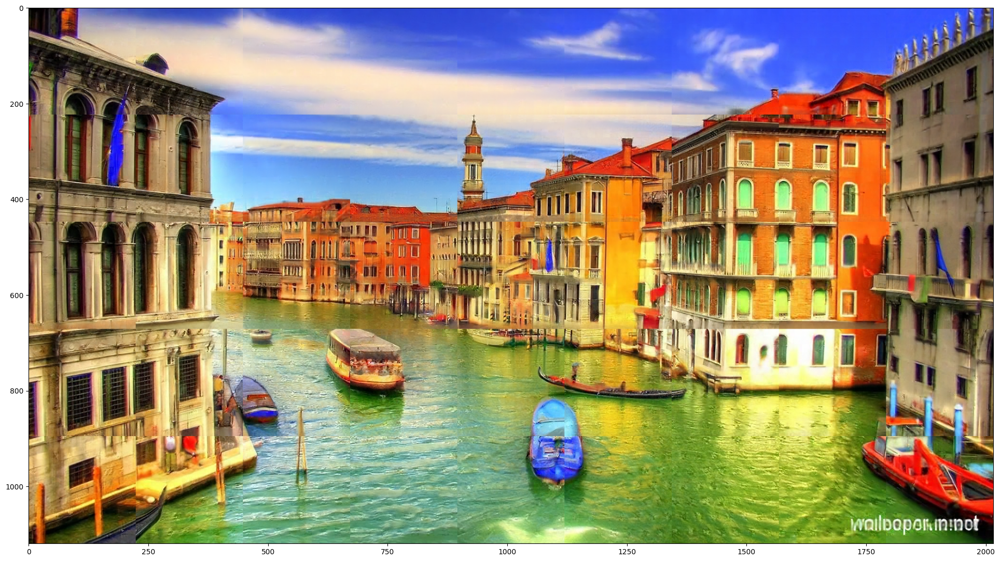

In [17]:
torch.manual_seed(2)
print('MAE with pixel reconstruction:')

new_img = np.zeros((1120, 2016, 3)).astype(int)

for y in range(5):
    for x in range(9):
        img = np.array(full_img)[y*224:(y+1)*224, x*224:(x+1)*224] / 255.

        img = img - imagenet_mean
        img = img / imagenet_std
        
        new_img[y*224:(y+1)*224, x*224:(x+1)*224] = reconstruct(img, model_mae_gan).int()[0]

plt.imshow(new_img)

/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/155843506.py:30: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return torch.clip((im_masked * imagenet_std + imagenet_mean) * 255, 0, 255).int()
/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/1052274954.py:10: DeprecationWarning: __array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments.
  new_img[y*224:(y+1)*224, x*224:(x+1)*224] = raw(img, model_mae_gan).int()[0]


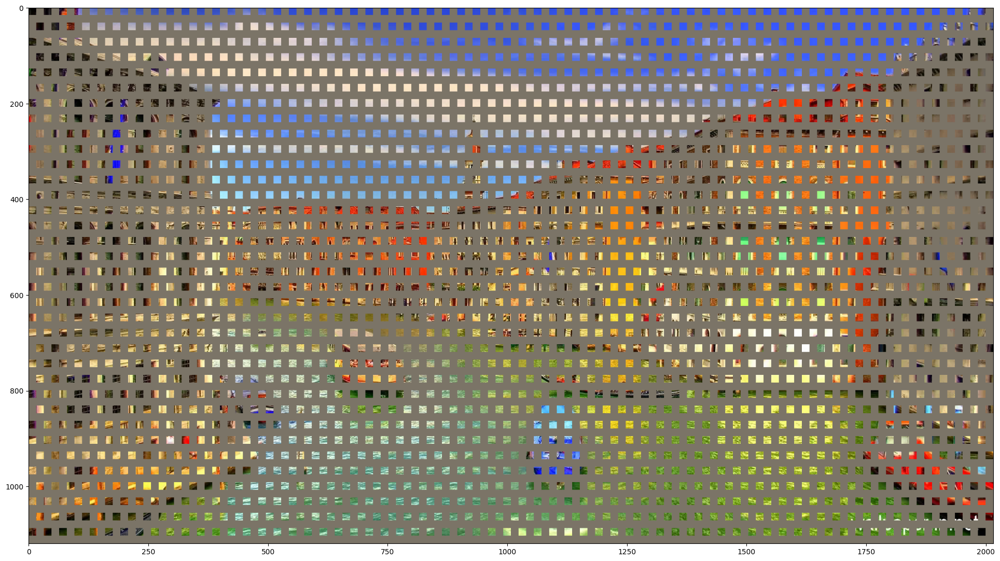

In [18]:
new_img = np.zeros((1120, 2016, 3)).astype(int)

for y in range(5):
    for x in range(9):
        img = np.array(full_img)[y*224:(y+1)*224, x*224:(x+1)*224] / 255.

        img = img - imagenet_mean
        img = img / imagenet_std
        
        new_img[y*224:(y+1)*224, x*224:(x+1)*224] = raw(img, model_mae_gan).int()[0]

plt.imshow(new_img)

In [19]:
print((224*17) , (224*9))

3808 2016


In [20]:
full_img = Image.open("lake.jpg")
full_img = full_img.resize((3808, 2016))

MAE with pixel reconstruction:


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/155843506.py:14: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return torch.clip((im_paste * imagenet_std + imagenet_mean) * 255, 0, 255).int()
/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/3828168566.py:13: DeprecationWarning: __array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments.
  new_img[y*224:(y+1)*224, x*224:(x+1)*224] = reconstruct(img, model_mae_gan).int()[0]


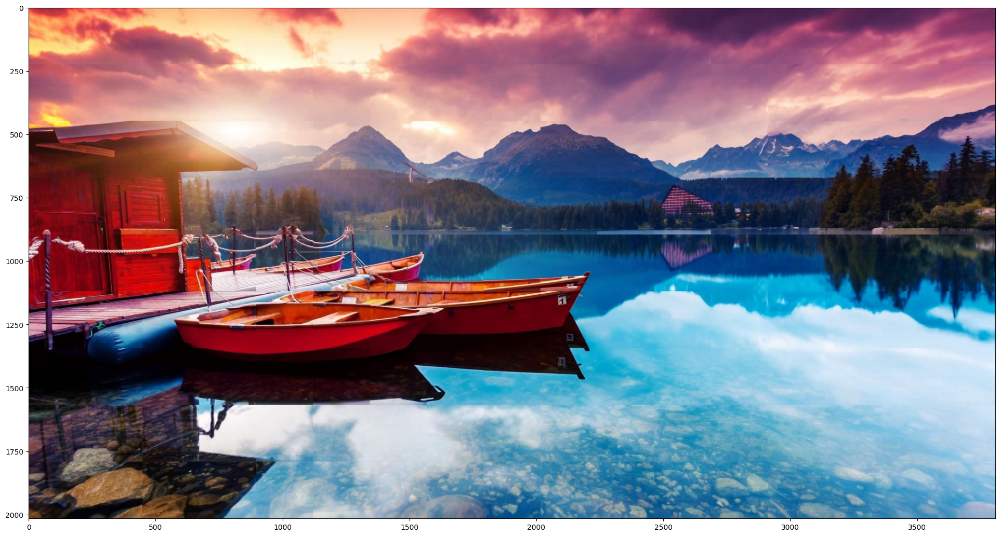

In [21]:
torch.manual_seed(2)
print('MAE with pixel reconstruction:')

new_img = np.zeros((2016, 3808, 3)).astype(int)

for y in range(9):
    for x in range(17):
        img = np.array(full_img)[y*224:(y+1)*224, x*224:(x+1)*224] / 255.

        img = img - imagenet_mean
        img = img / imagenet_std
        
        new_img[y*224:(y+1)*224, x*224:(x+1)*224] = reconstruct(img, model_mae_gan).int()[0]

plt.imshow(new_img)

MAE with pixel reconstruction:


/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/155843506.py:30: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return torch.clip((im_masked * imagenet_std + imagenet_mean) * 255, 0, 255).int()
/var/folders/kb/j2xtpg5d32lf478yq4spth8m0000gn/T/ipykernel_1737/1189157074.py:13: DeprecationWarning: __array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments.
  new_img[y*224:(y+1)*224, x*224:(x+1)*224] = raw(img, model_mae_gan).int()[0]


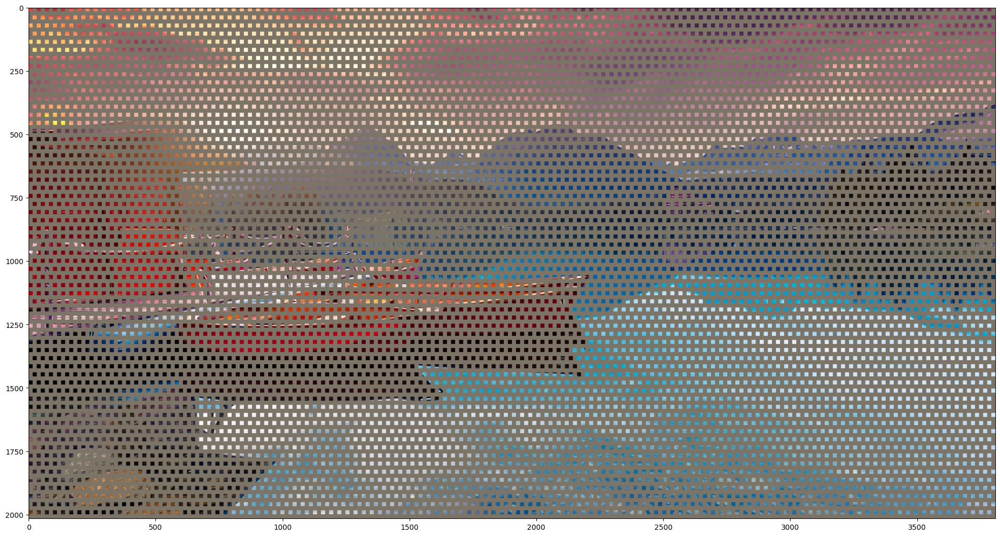

In [22]:
torch.manual_seed(2)
print('MAE with pixel reconstruction:')

new_img = np.zeros((2016, 3808, 3)).astype(int)

for y in range(9):
    for x in range(17):
        img = np.array(full_img)[y*224:(y+1)*224, x*224:(x+1)*224] / 255.

        img = img - imagenet_mean
        img = img / imagenet_std
        
        new_img[y*224:(y+1)*224, x*224:(x+1)*224] = raw(img, model_mae_gan).int()[0]

plt.imshow(new_img)